# Assessment of Deep Mutational Scanning Relative Fitness in Human HMBS Orthologues
##### Rayna Hamilton
##### October 6, 2022
##### Data provided by the [Roth lab](http://llama.mshri.on.ca/)

## Introduction

DMS-Barseq is an implementation of deep mutational scanning (DMS), a selection assay used to infer the functional effect of a gene's missense mutations.  Such experiments involve creating a barcoded plasmid library containing all possible missense mutation in a gene, then introducing these plasmids into a yeast strain containing a heat-sensitive orthologue of the gene of interest. Growth at both the permissive and selective termperatures, accompanied by sequencing to determine plasmid abundance at multiple timepoints, enables determination of each variant's fitness relative to the wild-type sequence [1].  However, this unicellular selection assay may not accurately reflect the selective pressures determining variants' relative fitness in multicellular organisms including humans. In particular, variants which exhibit greater-than-wildtype fitness (hypercomplementing variants) may be selectively disadvantageous or neutral in metazoans. The similarity between DMS and natural selection pressures can be tested by constructing phylogenetic trees of metazoan orthologues informed by site-specific substitution models derived from DMS data.  Such experimentally informed codon models (ExpCMs) are employed by the phylogenetic software phydms [2].  The relative fitness of hypercomplementing variants can be inferred by transforming DMS scores to either penalize these variants or cap their performance at wild-type fitness.   It has been previously demonstrated that for both the SUMO-conjugating enzyme UBE2I and its substrate, SUMO1, hypercomplementing variants are best treated as deleterious (see the original analysis [here](https://github.com/jbloomlab/AtlasPaper_SUMO1_UBE2I_ExpCM/blob/master/SUMO_and_UBE2I_analysis.ipynb)) [1].  We will assess whether this conclusion remains true in a new variant effect map generated for the human heme biosynthetic enzyme, human hydroxymethylbilane synthase (HMBS), whose inactivity can lead to Acute Intermittent Porphyria [3].

## Analysis

In [1]:
#import necessary modules
import subprocess
import os
import pandas as pd
import matplotlib.pyplot as plt
import subprocess
import phydmslib
import Bio.SeqIO
from IPython.display import Image, display
from pdf2image import convert_from_path
# DMS maps from the Roth lab
genes = ['HMBS', 'SUMO1', 'UBE2I']
purge = {'HMBS':'', 'SUMO1':'', 'UBE2I':'Ogar'} #Ogar occasionally leads to phylogeny crashes in UBE2I analysis

# perform analyses for all sequences with protein identities >= each of these cutoffs to the human DMS protein
identity_cutoffs = [0.85, 0.75]

def convertToPNG(file):
    pages = convert_from_path(file, 500)
    for page in pages:
        page.save(file[:-4]+'.png', 'PNG')

## Preprocess Ensemble Orthologue Alignments

Coding DNA alignments containing all metazoan orthologues available on Ensemble were downloaded on October 3, 2022. Links to the orthologue sets are below:

  [HMBS orthologues](http://uswest.ensembl.org/Homo_sapiens/Gene/Compara_Ortholog?db=core;g=ENSG00000256269;r=11:119084866-119093549).
  [SUMO1 orthologues](http://uswest.ensembl.org/Homo_sapiens/Gene/Compara_Ortholog?db=core;g=ENSG00000116030;r=2:202206182-202238599).
  [UBE2I orthologues](http://uswest.ensembl.org/Homo_sapiens/Gene/Compara_Ortholog?db=core;g=ENSG00000103275;r=16:1308880-1327018).

These alignments have been preprocessed to remove sites not present in the DMS data for each gene.  Below, we will use the program phydms_prepalignment to remove all alignment sites which are gapped in the human orthologue.  This program also removes some highly similar sequences, which are unlikely to provide much unique phylogenetic information, and removes sequences below a specified % identity with the human sequence.  The last step is performed as the selective pressures on the human orthologue may not be relevant on more highly diverged sequences.  For each gene, we will construct alignments with 75% and 85% identity to the human orthologue.

In [2]:
#read in DMS data and print sequences
hmbs, sumo, ube2i=pd.read_csv("scores/Combined_HMBS_Map_floored.csv"), pd.read_csv("scores/SUMO1_imputed_scores.csv"),pd.read_csv("scores/UBE2I_imputed_scores.csv")
aas={'Ala':'A','Arg':'R','Asn':'N','Asp':'D','Cys':'C','Glu':'E','Gln':'Q','Gly':'G','His':'H','Ile':'I','Leu':'L','Lys':'K','Met':'M','Phe':'F','Pro':'P','Ser':'S','Thr':'T','Trp':'W','Tyr':'Y','Val':'V','Ter':'*'}


temp=hmbs['hgvs_pro'].str.extract('(p.)([A-Za-z]{3})(\d+)(.*)')
hmbs['aa_ref']=temp[1]
hmbs['aa_pos']=temp[2]
hmbs['aa_alt']=temp[3]

#hmbs['fitness_refine']=hmbs['score']
sumo['score']=sumo['fitness_refine']
ube2i['score']=ube2i['fitness_refine']

for i,val in hmbs['aa_alt'].iteritems():
    if val=='=':       
        hmbs.at[i,'aa_alt']=hmbs['aa_ref'][i]
        
hmbs['aa_ref']=[aas[hmbs['aa_ref'][i]] for i in range(len(hmbs))]
hmbs['aa_alt']=[aas[hmbs['aa_alt'][i]] for i in range(len(hmbs))]

print("The DMS sequences are:")
for gene,df in {'SUMO1':sumo,'UBE2I':ube2i,'HMBS':hmbs}.items():
    print(gene)
    df['aa_pos']=df['aa_pos'].astype(int)
    seq=['']*(max(df['aa_pos'])+1)
    for aa,pos in zip(df['aa_ref'],df['aa_pos']):
        seq[pos]=aa
    print(''.join(seq))

The DMS sequences are:
SUMO1
SDQEAKPSTEDLGDKKEGEYIKLKVIGQDSSEIHFKVKMTTHLKKLKESYCQRQGVPMNSLRFLFEGQRIADNHTPKELGMEEEDVIEVYQEQTGG
UBE2I
SGIALSRLAQERKAWRKDHPFGFVAVPTKNPDGTMNLMNWECAIPGKKGTPWEGGLFKLRMLFKDDYPSSPPKCKFEPPLFHPNVYPSGTVCLSILEEDKDWRPAITIKQILLGIQELLNEPNIQDPAQAEAYTIYCQNRVEYEKRVRAQAKKFAPS
HMBS
RVIRVGTRKSQLARIQTDSVVATLKASYPGLQFEIIAMSTTGDKILDTALSKIGEKSLFTKELEHALEKNEVDLVVHSLKDLPTVLPPGFTIGAICKRENPHDAVVFHPKFVGKTLETLPEKSVVGTSSLRRAAQLQRKFPHLEFRSIRGNLNTRLRKLDEQQEFSAIILATAGLQRMGWHNRVGQILHPEECMYAVGQGALGVEVRAKDQDILDLVGVLHDPETLLRCIAERAFLRHLEGGCSVPVAVHTAMKDGQLYLTGGVWSLDGSDSIQETMQATIHVPAQHEDGPEDDPQLVGITARNIPRGPQLAAQNLGISLANLLLSKGAKNILDVARQLNDA



Getting HMBS homologs with >=0.85 protein identity to alignments/HMBS_alignment_protidentity_ge_0.85.fasta

Beginning execution of phydms_prepalignment in directory /home/jupyter/dms/hmbs_phydms_final at time Wed Oct  5 23:06:45 2022

Version information:
	Time and date: Wed Oct  5 23:06:45 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

Parsed the following command-line arguments:
	inseqs = alignments/Human_HMBS_orthologues_trimmed.fasta
	alignment = alignments/HMBS_alignment_protidentity_ge_0.85.fasta
	refseq = Hsap
	prealigned = True
	m

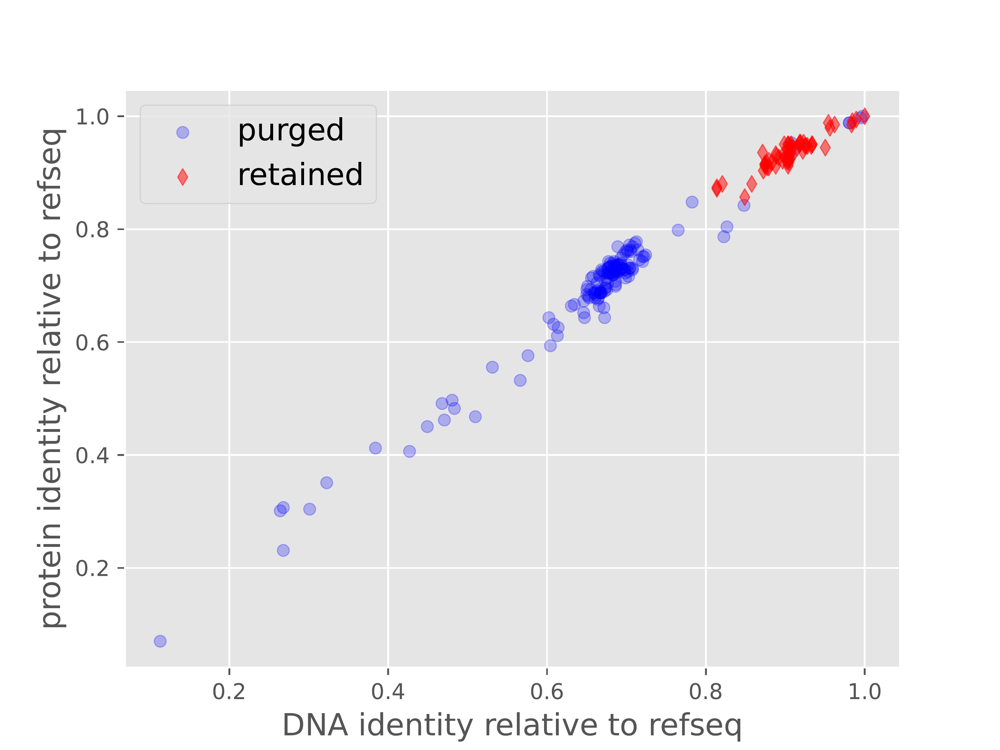


Getting HMBS homologs with >=0.75 protein identity to alignments/HMBS_alignment_protidentity_ge_0.75.fasta

Beginning execution of phydms_prepalignment in directory /home/jupyter/dms/hmbs_phydms_final at time Wed Oct  5 23:06:49 2022

Version information:
	Time and date: Wed Oct  5 23:06:49 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

Parsed the following command-line arguments:
	inseqs = alignments/Human_HMBS_orthologues_trimmed.fasta
	alignment = alignments/HMBS_alignment_protidentity_ge_0.75.fasta
	refseq = Hsap
	prealigned = True
	m

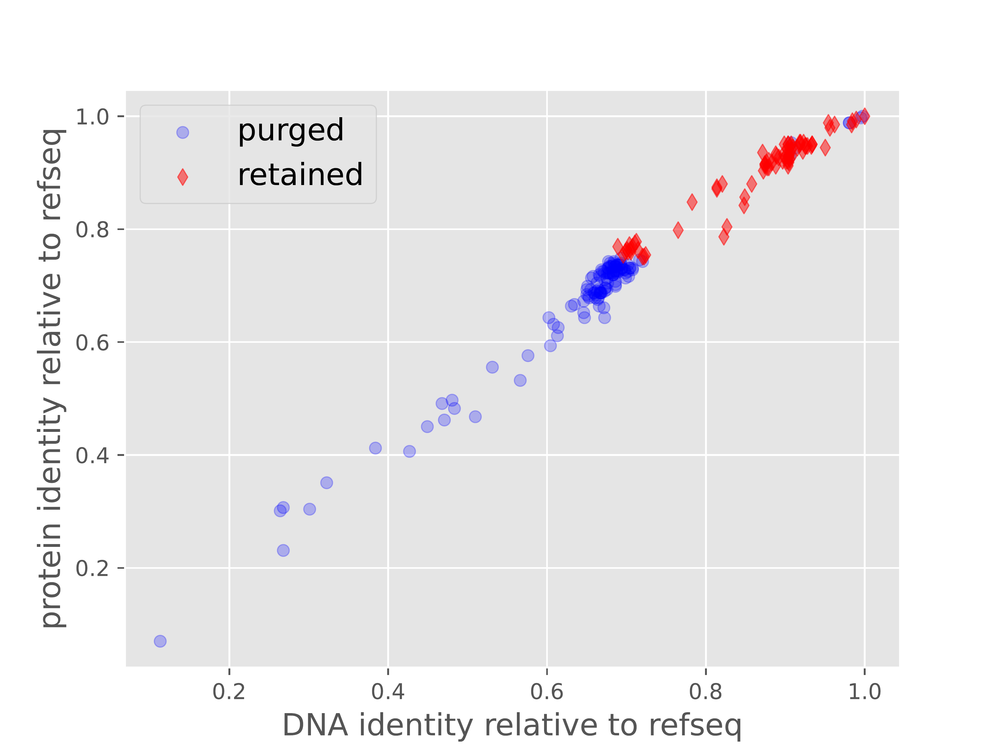


Getting SUMO1 homologs with >=0.85 protein identity to alignments/SUMO1_alignment_protidentity_ge_0.85.fasta

Beginning execution of phydms_prepalignment in directory /home/jupyter/dms/hmbs_phydms_final at time Wed Oct  5 23:06:54 2022

Version information:
	Time and date: Wed Oct  5 23:06:54 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

Parsed the following command-line arguments:
	inseqs = alignments/Human_SUMO1_orthologues_trimmed.fasta
	alignment = alignments/SUMO1_alignment_protidentity_ge_0.85.fasta
	refseq = Hsap
	prealigned = Tru

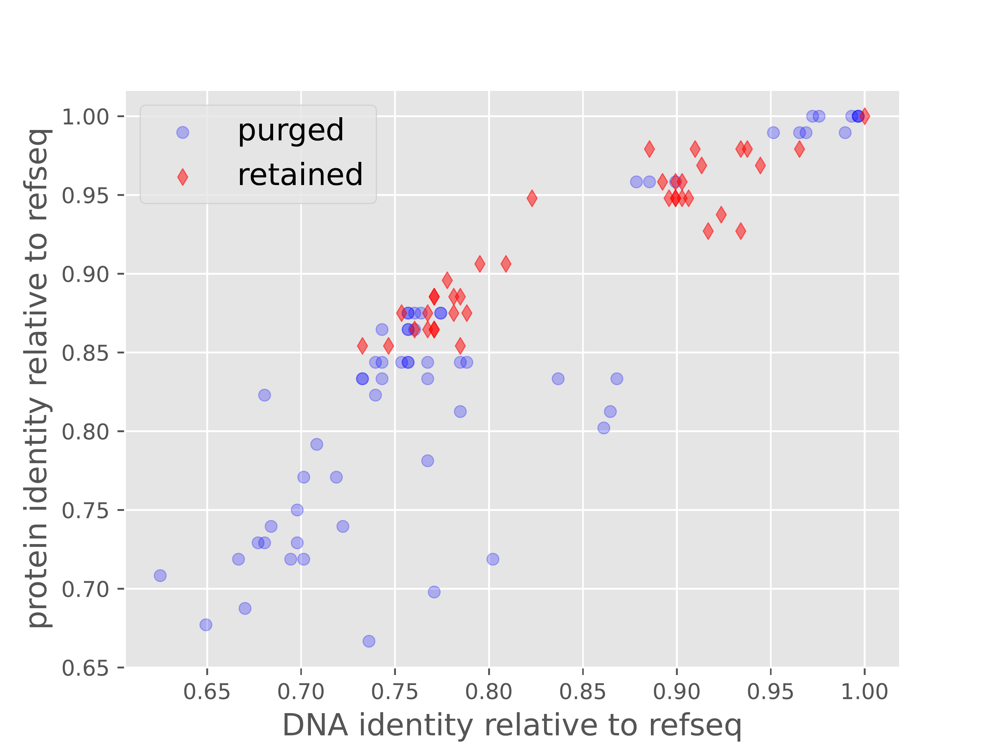


Getting SUMO1 homologs with >=0.75 protein identity to alignments/SUMO1_alignment_protidentity_ge_0.75.fasta

Beginning execution of phydms_prepalignment in directory /home/jupyter/dms/hmbs_phydms_final at time Wed Oct  5 23:06:57 2022

Version information:
	Time and date: Wed Oct  5 23:06:57 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

Parsed the following command-line arguments:
	inseqs = alignments/Human_SUMO1_orthologues_trimmed.fasta
	alignment = alignments/SUMO1_alignment_protidentity_ge_0.75.fasta
	refseq = Hsap
	prealigned = Tru

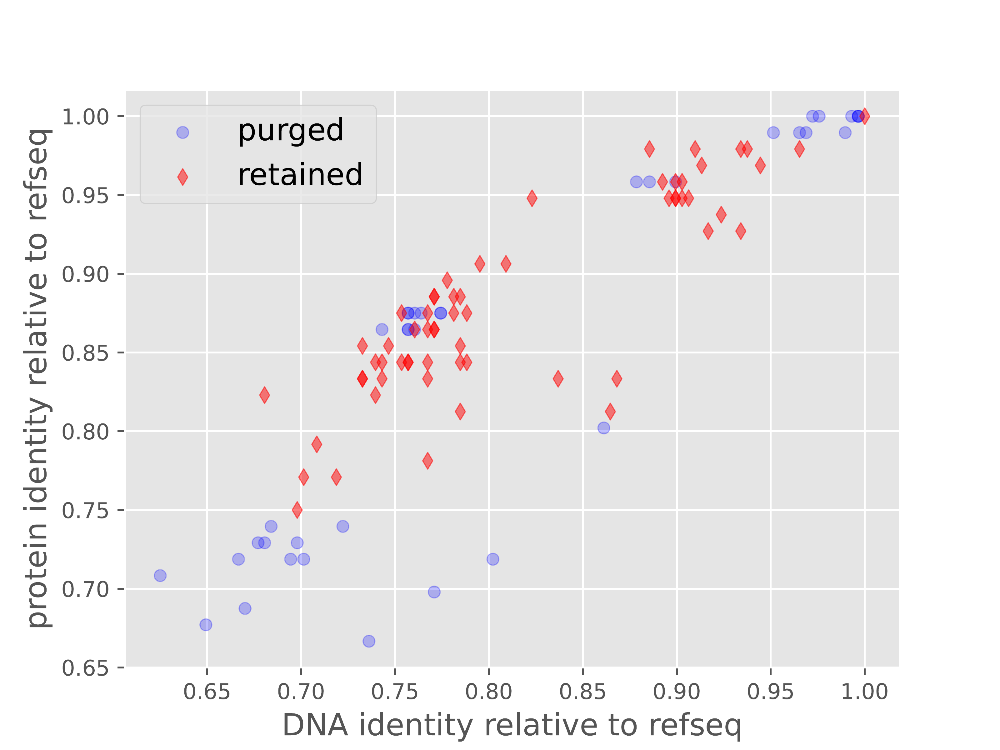


Getting UBE2I homologs with >=0.85 protein identity to alignments/UBE2I_alignment_protidentity_ge_0.85.fasta

Beginning execution of phydms_prepalignment in directory /home/jupyter/dms/hmbs_phydms_final at time Wed Oct  5 23:07:01 2022

Version information:
	Time and date: Wed Oct  5 23:07:01 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

Parsed the following command-line arguments:
	inseqs = alignments/Human_UBE2I_orthologues_trimmed.fasta
	alignment = alignments/UBE2I_alignment_protidentity_ge_0.85.fasta
	refseq = Hsap
	prealigned = Tru

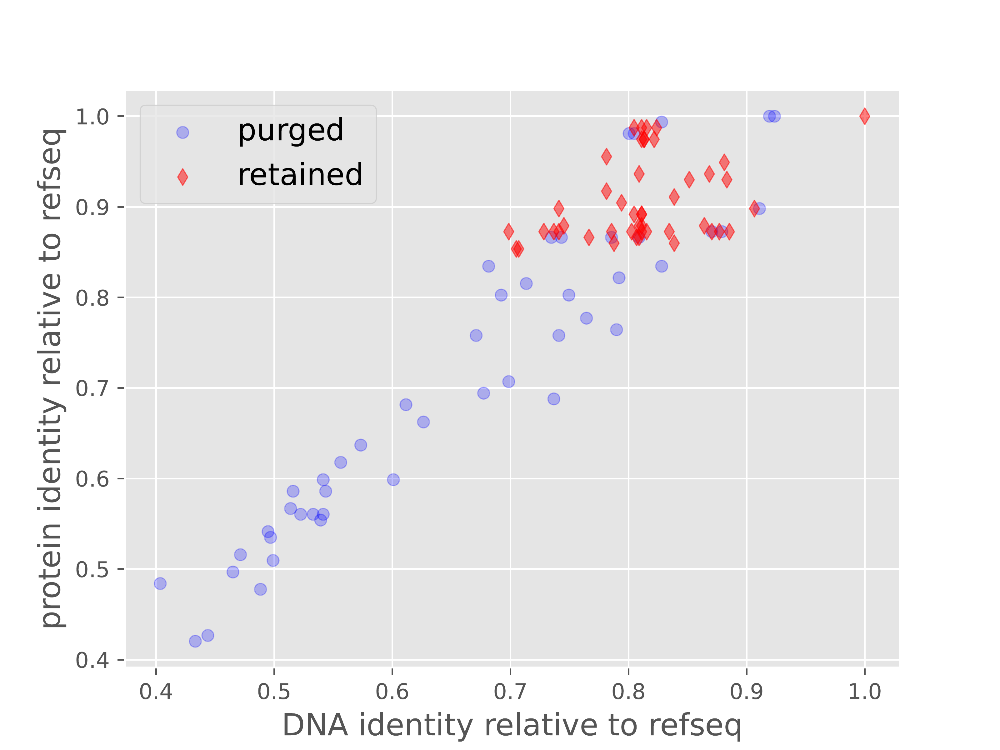


Getting UBE2I homologs with >=0.75 protein identity to alignments/UBE2I_alignment_protidentity_ge_0.75.fasta

Beginning execution of phydms_prepalignment in directory /home/jupyter/dms/hmbs_phydms_final at time Wed Oct  5 23:07:08 2022

Version information:
	Time and date: Wed Oct  5 23:07:08 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

Parsed the following command-line arguments:
	inseqs = alignments/Human_UBE2I_orthologues_trimmed.fasta
	alignment = alignments/UBE2I_alignment_protidentity_ge_0.75.fasta
	refseq = Hsap
	prealigned = Tru

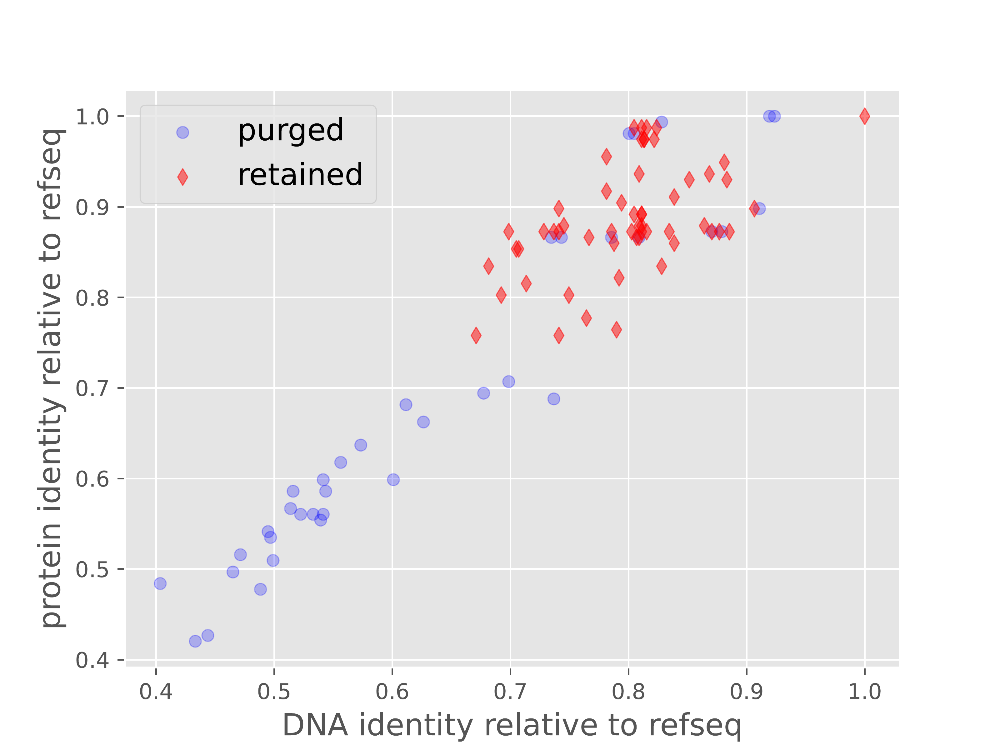

In [3]:
        
# get alignment of orthologs with gaps stripped relative to human protein used in DMS, filtered by protein identity
alignments = dict([(gene, {}) for gene in genes]) # keyed by gene, identity cutoff, value is file

folder='alignments/'   
for gene in genes:
    inseqs = folder+f'Human_{gene}_orthologues_trimmed.fasta'
    for cutoff in identity_cutoffs:
        alignmentfile = folder+f'{gene}_alignment_protidentity_ge_{cutoff}.fasta'
        alignments[gene][cutoff] = alignmentfile
        print(f"\nGetting {gene} homologs with >={cutoff} protein identity to {alignmentfile}")
        subprocess.check_call(['phydms_prepalignment',inseqs,alignmentfile,'Hsap', '--prealigned','--minidentity', str(cutoff),'--minuniqueness', '2','--purgeseqs', purge[gene]])

        nseqs = len(list(Bio.SeqIO.parse(alignmentfile, 'fasta')))
        print("Found {0} such sequences.\nHere is a plot showing what was retained:".format(nseqs))
        convertToPNG(os.path.splitext(alignmentfile)[0] + '.pdf')
        display(Image(os.path.splitext(alignmentfile)[0] + '.png'))

## Calculate amino acid preferences from DMS scores 
The relative fitness of amino acid substitutions have undergone processing and [imputation](http://impute.varianteffect.org) steps to remove low-quality data and to impute likely values for missing data points.  We will generate three sets of scores from this DMS data, representing three hypotheses about the effects of hypercomplementing variants in nature.

  1. Untransformed scores: indicating that mutations which confer a selective advantage in DMS will also do so in nature.
  
  2. Scores maxed out at 1: $s_{r,a} > 1$ to a value of $s_{r,a} = 1$. This indicates that hypercomplementing variants are equal in fitness to wild-type.

  3. Penalized scores greater than 1: If $s_{r,a} > 1$, then we transform it to a value of $1 / s_{r,a}$. This indicates that hypercomplementing variants are detrimental, or deleterious, in natural evolution. 

We then calculate the preference for each variant based on its score. Phydms defines the preference $\pi_{r,a}$ for amino-acid $a$ at site $r$ in terms of the fitness score $s_{r,a}$ as $\pi_{r,a} = \frac{s_{r,a}}{\sum_{a'} s_{r,a'}}$. (The preferences are the scores normalized to sum to one at each site). Note that before performing this calculation we first set each score to be at least as large as a small number (0.0001) to deal with negative and zero scores.

The cell below calculates these values and outputs them to preferences files, which will be used to create site-specific evolutionary models for phydms. Note that we will first normalize each variant's score relative to the wild-type score for that position to avoid penalizing the wild-type variant itself in cases where its score is slightly greater than one.  The logoplots generated are distinct from alignment-based sequence logoplots as they represent the DMS preference for each amino acid, rather than the occurence of each character in an alignment.  

Untransformed preferences logoplot for gene SUMO1:


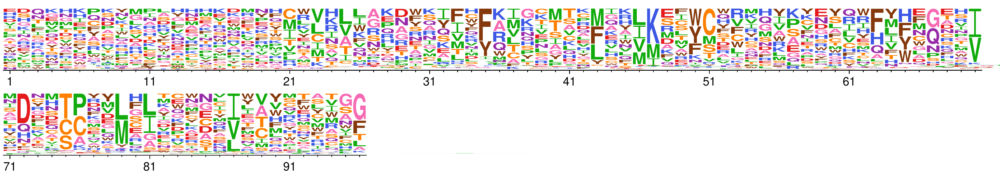

Untransformed preferences logoplot for gene UBE2I:


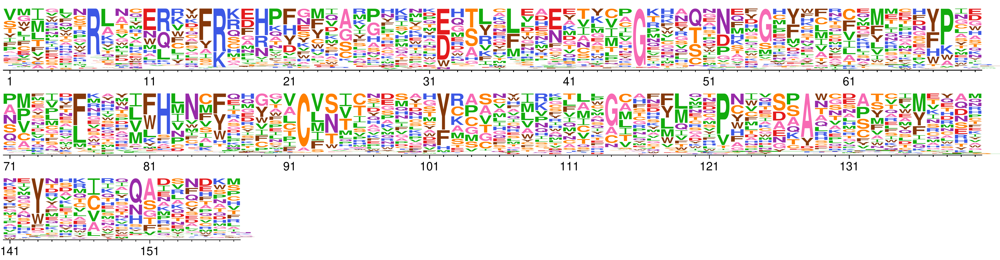

Untransformed preferences logoplot for gene HMBS:


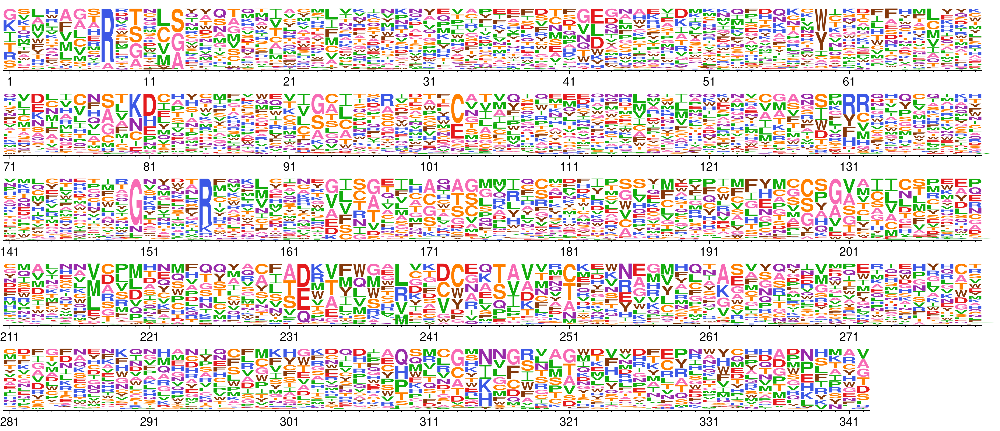


Here is the distribution of scores.


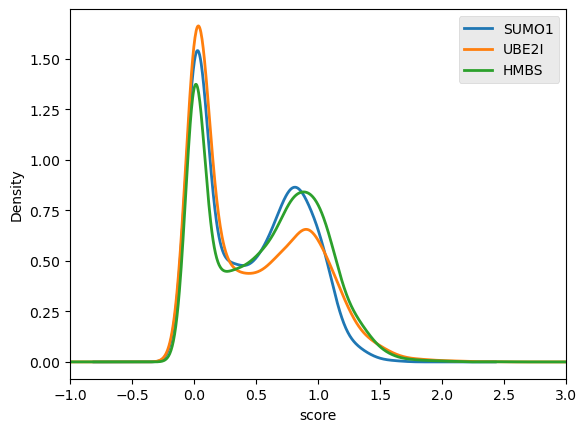

In [4]:
%gui qt
%matplotlib inline

from pdf2image import convert_from_path
from IPython.display import Image,display
hmbs['aa_pos']=hmbs['aa_pos'].astype(int)
minscore = 1e-4 # any score less than this is set to this value to avoid zero / negative values.

if not os.path.exists('logoplots'):
    os.mkdir('logoplots')

prefs = {} # dictionary holding names of file with preferences, keyed by *gene* and then by *scoretype*
prefsdir = './prefs/'
if not os.path.isdir(prefsdir):
    os.mkdir(prefsdir)

scoretransforms = {
        'untransformed': lambda s: s,
        'max-scores-at-1': lambda s: min(1.0, s),
        'penalize-scores-gt1': lambda s: s if s <= 1 else 1.0 / s,
        }

# get preferences from scores
characters = ['A','C','D','E','F','G','H','I','K','L','M','N','P','Q','R','S','T','V','W','Y'] #list of possible amino acid characters accepted as input by phydms
for gene,df in {'SUMO1':sumo,'UBE2I':ube2i,'HMBS':hmbs}.items():
    prefs[gene] = {}
    df['score'].plot(kind='kde', lw=2, label='{0}'.format(gene))
    sites = [] #list of included site indices
    wts = {} #wild-type amino acid for each site
    df['score']=df['score'].fillna(0)
    
    for (scoretransform, lambdaf) in scoretransforms.items():
        #print(gene,scoretransform)
        new_df=pd.DataFrame({char:[0.0 for i in range(max(df['aa_pos']-min(df['aa_pos']))+1)] for char in aas.values()})
        min_pos=min(df['aa_pos'])
        for (irow, row) in df.iterrows():
            if len(df[(df['aa_alt']==row['aa_ref']) & (df['aa_pos']==row['aa_pos'])])==1:
                new_df.at[row['aa_pos']-min_pos,row['aa_alt']]=lambdaf(max(minscore,row['score']/max(minscore,float(df[(df['aa_alt']==row['aa_ref']) & (df['aa_pos']==row['aa_pos'])]['score'])))) #normalize to wild-type, round up to 0.0001 if necessary, then perform score transformation of interest
            else: 
                new_df.at[row['aa_pos']-min_pos,row['aa_alt']]=lambdaf(max(minscore,row['score']))
        for (irow,row) in new_df.iterrows():
            new_df.at[irow,:]=row/sum(row)#divide score by sum of that position's scores to get preference
        for (irow,row) in new_df.iterrows():
            for i,val in row.iteritems():
                new_df.at[irow,i]=max(minscore,val)
        new_df.insert(0, "site", range(1,len(new_df)+1))
        new_df.to_csv(f"prefs/{gene}_{scoretransform}_new_prefs.csv", index = False)
        #print(new_df.iloc[:,:9].head(6).to_string(index = False))
    print(f"Untransformed preferences logoplot for gene {gene}:")
    subprocess.check_call(['phydms_logoplot',f'prefs/{gene}_logoplot.pdf','--prefs',f'prefs/{gene}_untransformed_new_prefs.csv'],stdout=subprocess.DEVNULL)
    convertToPNG(f'logoplots/{gene}_logoplot.pdf')
    display(Image(filename=f'logoplots/{gene}_logoplot.png'))
    
# distribution of scores

plt.style.use("ggplot")
print("\nHere is the distribution of scores.")
plt.legend()
plt.xlim(-1, 3)
plt.xlabel('score')
plt.show()


The bimodal score density plot indicates that all three genes exhibit two broad groups of variants: those with near-wildtype fitness (1.0) and those with significantly decreased fitness (~<0.5).  We can see the presence of rare hypercomplementing variants in the upper-right tail of the plot.  The logoplots of the untransformed preferences illustrate that all three genes exhibit many sites where multiple variants have similar levels of fitness, as well as a few sites where one residue is highly preferred.  

## Using site-specific preferences to inform phylogenetic tree construction

We can now fit phylogenetic trees using substitution models informed by the deep mutational scanning data for each set of orthologs. These trees are constructed using phydms_comprehensive and are compared to trees informed by the M0 and M5 variants of the Goldman-Yang substitution models [4].  The program will also construct trees where the amino-acid preferences have either been randomized or averaged among sites.  This step is a sanity check; it is expected that either transformation of DMS data should perform significantly worse than unaltered DMS data.

In [5]:
phydmsdir = f'./phydms_results/'
if not os.path.isdir(phydmsdir):
    os.mkdir(phydmsdir)

transforms=[scoretransform for scoretransform in scoretransforms.keys()]
modelcomparisons = dict([(gene, {}) for gene in genes])
prefixes = {}
for gene in genes:
    if not os.path.isdir(phydmsdir+gene):
        os.mkdir(phydmsdir+gene)
    prefixes[gene] = {}
    for cutoff in identity_cutoffs:
        alignment = alignments[gene][cutoff]
        outprefix = f'{phydmsdir}/{gene}/{gene}_identity-ge-{cutoff}'
        prefixes[gene][cutoff] = outprefix
        modelcomparisons[gene][cutoff] = outprefix + '_modelcomparison.txt'
        print(f"\nAnalyzing {gene} using homologs with identity >= {cutoff}...")
        #subprocess.call(['phydms_comprehensive',outprefix,f'/home/jupyter/dms/alignments/{gene}_alignment_protidentity_ge_{cutoff}.fasta',f'/home/jupyter/dms/prefs/{gene}_{transforms[0]}_new_prefs.csv',f'/home/jupyter/dms/prefs/{gene}_{transforms[1]}_new_prefs.csv',f'/home/jupyter/dms/prefs/{gene}_{transforms[2]}_new_prefs.csv','--randprefs','--raxml','/home/jupyter/install/standard-RAxML-master/raxmlHPC','--ncpus','8'])
        subprocess.call(['phydms_comprehensive',outprefix,f'./alignments/{gene}_alignment_protidentity_ge_{cutoff}.fasta',f'./prefs/{gene}_penalize-scores-gt1_new_prefs.csv',f'./prefs/{gene}_untransformed_new_prefs.csv',f'./prefs/{gene}_max-scores-at-1_new_prefs.csv','--randprefs','--raxml','/home/jupyter/install/standard-RAxML-master/raxmlHPC'])



Analyzing HMBS using homologs with identity >= 0.85...


2022-10-05 23:08:38,389 - INFO - Beginning execution of phydms_comprehensive in directory /home/jupyter/dms/hmbs_phydms_final

2022-10-05 23:08:38,389 - INFO - Progress is being logged to ./phydms_results//HMBS/HMBS_identity-ge-0.85.log

2022-10-05 23:08:38,389 - INFO - Version information:
	Time and date: Wed Oct  5 23:08:37 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

2022-10-05 23:08:38,389 - INFO - Parsed the following command-line arguments:
	outprefix = ./phydms_results//HMBS/HMBS_identity-ge-0.85_
	alignment = ./alignments/HMBS_al


Analyzing HMBS using homologs with identity >= 0.75...


2022-10-05 23:44:38,371 - INFO - Beginning execution of phydms_comprehensive in directory /home/jupyter/dms/hmbs_phydms_final

2022-10-05 23:44:38,372 - INFO - Progress is being logged to ./phydms_results//HMBS/HMBS_identity-ge-0.75.log

2022-10-05 23:44:38,372 - INFO - Version information:
	Time and date: Wed Oct  5 23:44:37 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

2022-10-05 23:44:38,372 - INFO - Parsed the following command-line arguments:
	outprefix = ./phydms_results//HMBS/HMBS_identity-ge-0.75_
	alignment = ./alignments/HMBS_al


Analyzing SUMO1 using homologs with identity >= 0.85...


2022-10-06 00:17:27,132 - INFO - Beginning execution of phydms_comprehensive in directory /home/jupyter/dms/hmbs_phydms_final

2022-10-06 00:17:27,134 - INFO - Progress is being logged to ./phydms_results//SUMO1/SUMO1_identity-ge-0.85.log

2022-10-06 00:17:27,134 - INFO - Version information:
	Time and date: Thu Oct  6 00:17:23 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

2022-10-06 00:17:27,137 - INFO - Parsed the following command-line arguments:
	outprefix = ./phydms_results//SUMO1/SUMO1_identity-ge-0.85_
	alignment = ./alignments/SUM


Analyzing SUMO1 using homologs with identity >= 0.75...


2022-10-06 00:32:47,895 - INFO - Beginning execution of phydms_comprehensive in directory /home/jupyter/dms/hmbs_phydms_final

2022-10-06 00:32:47,896 - INFO - Progress is being logged to ./phydms_results//SUMO1/SUMO1_identity-ge-0.75.log

2022-10-06 00:32:47,896 - INFO - Version information:
	Time and date: Thu Oct  6 00:32:47 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

2022-10-06 00:32:47,896 - INFO - Parsed the following command-line arguments:
	outprefix = ./phydms_results//SUMO1/SUMO1_identity-ge-0.75_
	alignment = ./alignments/SUM


Analyzing UBE2I using homologs with identity >= 0.85...


2022-10-06 00:46:26,240 - INFO - Beginning execution of phydms_comprehensive in directory /home/jupyter/dms/hmbs_phydms_final

2022-10-06 00:46:26,240 - INFO - Progress is being logged to ./phydms_results//UBE2I/UBE2I_identity-ge-0.85.log

2022-10-06 00:46:26,240 - INFO - Version information:
	Time and date: Thu Oct  6 00:46:25 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

2022-10-06 00:46:26,240 - INFO - Parsed the following command-line arguments:
	outprefix = ./phydms_results//UBE2I/UBE2I_identity-ge-0.85_
	alignment = ./alignments/UBE


Analyzing UBE2I using homologs with identity >= 0.75...


2022-10-06 01:00:38,380 - INFO - Beginning execution of phydms_comprehensive in directory /home/jupyter/dms/hmbs_phydms_final

2022-10-06 01:00:38,381 - INFO - Progress is being logged to ./phydms_results//UBE2I/UBE2I_identity-ge-0.75.log

2022-10-06 01:00:38,381 - INFO - Version information:
	Time and date: Thu Oct  6 01:00:37 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

2022-10-06 01:00:38,381 - INFO - Parsed the following command-line arguments:
	outprefix = ./phydms_results//UBE2I/UBE2I_identity-ge-0.75_
	alignment = ./alignments/UBE

## Phydms output

Phydms describes model goodness-of-fit using the Aikaike information criterion, which penalizes the tree log likelihood according to the number of free parameters. Models are sorted from best (lowest AIC) to worst (highest AIC). Note that *ExpCM* denotes *experimentally informed codon model*, and *YNGKP* indicates a Goldman-Yang style standard substitution model.  Recall that we generated two alignments for each gene with either 75% or 85% identity to the human orthologue.  As the DMS data measures selection pressure on the human orthologue only, it is possible that it will not be relevant to the more distantly-related orthologue set, a result which would be demonstrated by worse AICs relative to the best-performing model.

In [6]:

for gene in genes:
    for cutoff in identity_cutoffs:
        filename = f'./phydms_results/{gene}/{gene}_identity-ge-{cutoff}_modelcomparison.md'
        if os.path.exists(filename):

            print("\nThe model comparisons for {0} using orthologs with >= {1}% protein identity are found in file {2}".format(gene,str(cutoff)[2:],filename))
            df=pd.read_csv(filename,sep="|")
            df.columns=[col.strip() for col in df.columns]
            display(df[["Model","deltaAIC","LogLikelihood","nParams","ParamValues"]])


The model comparisons for HMBS using orthologs with >= 85% protein identity are found in file ./phydms_results/HMBS/HMBS_identity-ge-0.85_modelcomparison.md


,Model,deltaAIC,LogLikelihood,nParams,ParamValues
0,----------------------------------------------...,----------,---------------,---------,-----------------------------------------------
1,ExpCM_HMBS_penalize-scores-gt1_new_prefs ...,0.00,-11371.91,6,"beta=0.58, kappa=3.68, omega=0.12"
2,YNGKP_M5 ...,24.14,-11377.98,12,"alpha_omega=0.36, beta_omega=2.75, kappa=3.81"
3,ExpCM_HMBS_max-scores-at-1_new_prefs ...,38.04,-11390.93,6,"beta=0.53, kappa=3.67, omega=0.12"
4,ExpCM_HMBS_untransformed_new_prefs ...,75.66,-11409.74,6,"beta=0.47, kappa=3.67, omega=0.11"
5,averaged_ExpCM_HMBS_untransformed_new_prefs ...,268.70,-11506.26,6,"beta=0.26, kappa=3.64, omega=0.11"
6,averaged_ExpCM_HMBS_penalize-scores-gt1_new_p...,268.86,-11506.34,6,"beta=0.23, kappa=3.64, omega=0.11"
7,averaged_ExpCM_HMBS_max-scores-at-1_new_prefs...,269.12,-11506.47,6,"beta=0.22, kappa=3.64, omega=0.11"
8,randomized_ExpCM_HMBS_penalize-scores-gt1_new...,269.34,-11506.58,6,"beta=0.03, kappa=3.65, omega=0.11"
9,randomized_ExpCM_HMBS_max-scores-at-1_new_pre...,269.42,-11506.62,6,"beta=0.03, kappa=3.65, omega=0.11"



The model comparisons for SUMO1 using orthologs with >= 85% protein identity are found in file ./phydms_results/SUMO1/SUMO1_identity-ge-0.85_modelcomparison.md


,Model,deltaAIC,LogLikelihood,nParams,ParamValues
0,----------------------------------------------...,----------,---------------,---------,-----------------------------------------------
1,ExpCM_SUMO1_penalize-scores-gt1_new_prefs ...,0.00,-3154.52,6,"beta=0.92, kappa=1.99, omega=0.08"
2,ExpCM_SUMO1_max-scores-at-1_new_prefs ...,30.52,-3169.78,6,"beta=0.76, kappa=2.02, omega=0.07"
3,ExpCM_SUMO1_untransformed_new_prefs ...,36.90,-3172.97,6,"beta=0.72, kappa=2.03, omega=0.07"
4,randomized_ExpCM_SUMO1_penalize-scores-gt1_ne...,141.50,-3225.27,6,"beta=0.01, kappa=2.07, omega=0.06"
5,averaged_ExpCM_SUMO1_penalize-scores-gt1_new_...,141.52,-3225.28,6,"beta=0.00, kappa=2.08, omega=0.06"
6,averaged_ExpCM_SUMO1_untransformed_new_prefs ...,141.52,-3225.28,6,"beta=0.00, kappa=2.08, omega=0.06"
7,randomized_ExpCM_SUMO1_untransformed_new_pref...,141.52,-3225.28,6,"beta=0.00, kappa=2.07, omega=0.06"
8,averaged_ExpCM_SUMO1_max-scores-at-1_new_pref...,141.52,-3225.28,6,"beta=0.00, kappa=2.08, omega=0.06"
9,randomized_ExpCM_SUMO1_max-scores-at-1_new_pr...,141.52,-3225.28,6,"beta=0.01, kappa=2.07, omega=0.06"



The model comparisons for SUMO1 using orthologs with >= 75% protein identity are found in file ./phydms_results/SUMO1/SUMO1_identity-ge-0.75_modelcomparison.md


,Model,deltaAIC,LogLikelihood,nParams,ParamValues
0,----------------------------------------------...,----------,---------------,---------,-----------------------------------------------
1,ExpCM_SUMO1_penalize-scores-gt1_new_prefs ...,0.00,-5670.12,6,"beta=0.76, kappa=1.66, omega=0.12"
2,ExpCM_SUMO1_max-scores-at-1_new_prefs ...,48.68,-5694.46,6,"beta=0.58, kappa=1.68, omega=0.11"
3,ExpCM_SUMO1_untransformed_new_prefs ...,57.72,-5698.98,6,"beta=0.55, kappa=1.68, omega=0.11"
4,randomized_ExpCM_SUMO1_penalize-scores-gt1_ne...,180.44,-5760.34,6,"beta=0.04, kappa=1.72, omega=0.09"
5,randomized_ExpCM_SUMO1_max-scores-at-1_new_pr...,180.54,-5760.39,6,"beta=0.03, kappa=1.72, omega=0.09"
6,randomized_ExpCM_SUMO1_untransformed_new_pref...,180.76,-5760.50,6,"beta=0.03, kappa=1.72, omega=0.09"
7,averaged_ExpCM_SUMO1_untransformed_new_prefs ...,181.06,-5760.65,6,"beta=0.05, kappa=1.72, omega=0.09"
8,averaged_ExpCM_SUMO1_max-scores-at-1_new_pref...,181.08,-5760.66,6,"beta=0.02, kappa=1.73, omega=0.09"
9,averaged_ExpCM_SUMO1_penalize-scores-gt1_new_...,181.10,-5760.67,6,"beta=0.02, kappa=1.73, omega=0.09"



The model comparisons for UBE2I using orthologs with >= 85% protein identity are found in file ./phydms_results/UBE2I/UBE2I_identity-ge-0.85_modelcomparison.md


,Model,deltaAIC,LogLikelihood,nParams,ParamValues
0,----------------------------------------------...,----------,---------------,---------,-----------------------------------------------
1,YNGKP_M5 ...,0.00,-6996.86,12,"alpha_omega=0.39, beta_omega=1.95, kappa=1.63"
2,ExpCM_UBE2I_penalize-scores-gt1_new_prefs ...,167.42,-7086.57,6,"beta=0.64, kappa=1.90, omega=0.13"
3,ExpCM_UBE2I_untransformed_new_prefs ...,213.18,-7109.45,6,"beta=0.53, kappa=1.89, omega=0.12"
4,ExpCM_UBE2I_max-scores-at-1_new_prefs ...,216.34,-7111.03,6,"beta=0.53, kappa=1.90, omega=0.12"
5,averaged_ExpCM_UBE2I_penalize-scores-gt1_new_...,389.58,-7197.65,6,"beta=0.00, kappa=1.88, omega=0.09"
6,randomized_ExpCM_UBE2I_penalize-scores-gt1_ne...,389.58,-7197.65,6,"beta=0.00, kappa=1.88, omega=0.09"
7,averaged_ExpCM_UBE2I_untransformed_new_prefs ...,389.58,-7197.65,6,"beta=0.00, kappa=1.88, omega=0.09"
8,randomized_ExpCM_UBE2I_untransformed_new_pref...,389.58,-7197.65,6,"beta=0.00, kappa=1.88, omega=0.09"
9,averaged_ExpCM_UBE2I_max-scores-at-1_new_pref...,389.58,-7197.65,6,"beta=0.00, kappa=1.88, omega=0.09"



The model comparisons for UBE2I using orthologs with >= 75% protein identity are found in file ./phydms_results/UBE2I/UBE2I_identity-ge-0.75_modelcomparison.md


,Model,deltaAIC,LogLikelihood,nParams,ParamValues
0,----------------------------------------------...,----------,---------------,---------,-----------------------------------------------
1,YNGKP_M5 ...,0.00,-9042.54,12,"alpha_omega=0.55, beta_omega=2.72, kappa=1.72"
2,ExpCM_UBE2I_penalize-scores-gt1_new_prefs ...,160.24,-9128.66,6,"beta=0.57, kappa=1.99, omega=0.14"
3,ExpCM_UBE2I_untransformed_new_prefs ...,208.40,-9152.74,6,"beta=0.47, kappa=1.98, omega=0.13"
4,ExpCM_UBE2I_max-scores-at-1_new_prefs ...,213.00,-9155.04,6,"beta=0.47, kappa=1.99, omega=0.13"
5,averaged_ExpCM_UBE2I_untransformed_new_prefs ...,392.58,-9244.83,6,"beta=0.00, kappa=1.97, omega=0.10"
6,randomized_ExpCM_UBE2I_untransformed_new_pref...,392.58,-9244.83,6,"beta=0.00, kappa=1.97, omega=0.10"
7,averaged_ExpCM_UBE2I_max-scores-at-1_new_pref...,392.58,-9244.83,6,"beta=0.00, kappa=1.97, omega=0.10"
8,randomized_ExpCM_UBE2I_max-scores-at-1_new_pr...,392.58,-9244.83,6,"beta=0.00, kappa=1.97, omega=0.10"
9,averaged_ExpCM_UBE2I_penalize-scores-gt1_new_...,392.60,-9244.84,6,"beta=0.00, kappa=1.97, omega=0.10"


## Interpreting the model results

Unsurprisingly, all DMS-informed models significantly outperform those where the preferences are randomized or averaged across sites.  The DMS models also outperform the YNGKP M0 model, which assumes a consistent synonymous/nonsynonymous substitution ratio ω for all sites [4].  The YNGKP M5 model, which assumes a gamma distribution for this ratio across all sites, does however outperform the UBE2I DMS data and the HMBS data when the more distantly related orthologue set is used [4].  This result may indicate that a gamma distribution is a reasonable model for this gene's substitution rates, or that the DMS selective pressures differ significantly from the selective pressures present in metazoans.  For HMBS, the selective pressures observed in DMS data appear to only be relevant to the more closely-related orthologue set.  For all three genes and orthologue sets, penalizing the hypercomplementing variants produces the best-performing model.  This result indicates that missense mutations which improve survival in yeast complementation assays tend to be detrimental in metazoan evolution.  This result is consistent with the previous SUMO1 and UBE2I analysis, but is a novel finding for the newly-mapped HMBS [1].  

### Interpreting differences in the stringency of selection in nature and in the experiments

Phydms output includes a stringency parameter, beta, describing the degree to which evolution in the orthologues of interest prefers the same variants.  Values greater than one indicate that the same variants are favoured with greater stringency (greater selective pressure), while values below one indicate lower stringency of selection.  Unsurprisingly, beta is always very close to 0 for the randomized and averaged ExpCM models, indicating no real relationship between the DMS models and natural evolution [2]. We can create logoplots describing the preferences in the best-performing models (those where hypercomplementing variants are penalized), then adjust these logoplots according to the stringency observed in phylogenies.


For gene HMBS, the stringency parameter is 0.576978
Here is the preferences logoplot with hypercomplementing scores penalized:


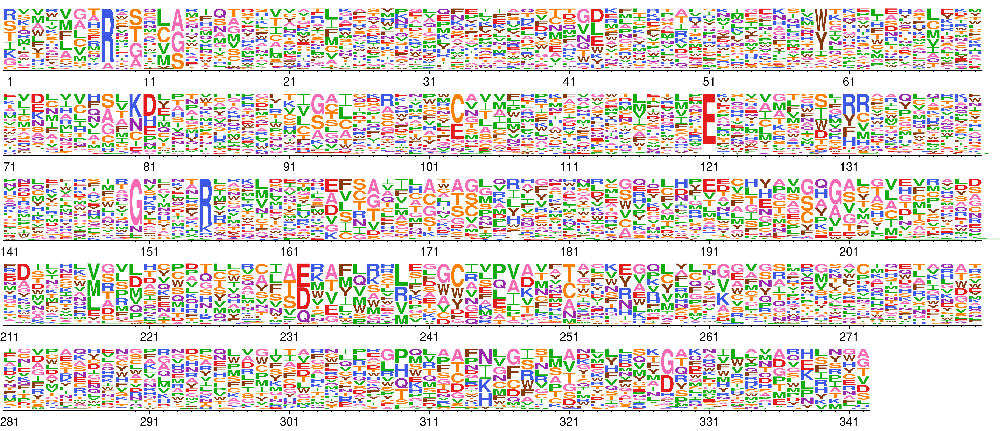

Here is the preferences logoplot with hypercomplementing scores penalized, rescaled according to stringency:


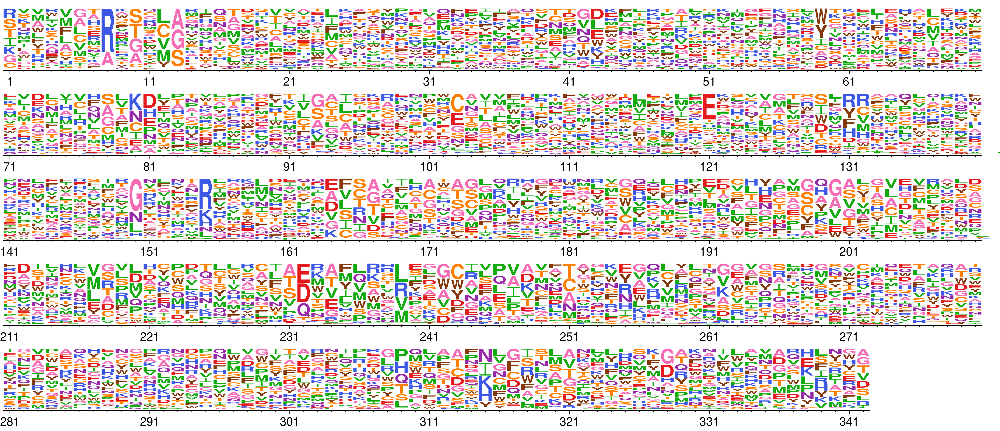


For gene SUMO1, the stringency parameter is 0.920809
Here is the preferences logoplot with hypercomplementing scores penalized:


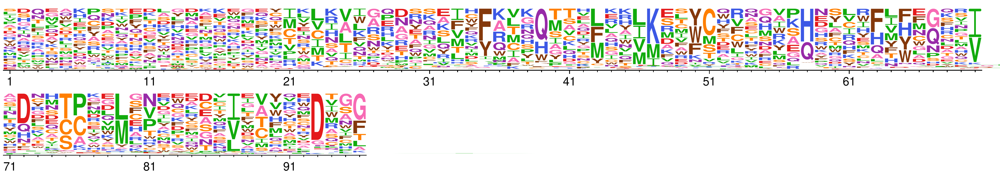

Here is the preferences logoplot with hypercomplementing scores penalized, rescaled according to stringency:


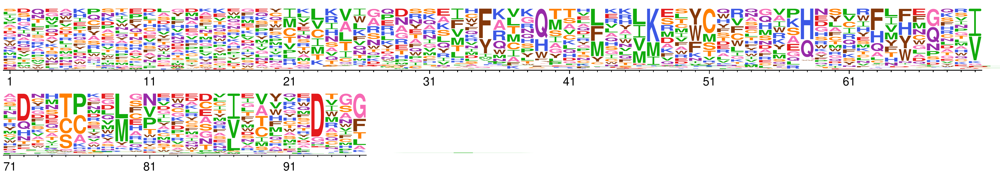


For gene UBE2I, the stringency parameter is 0.6426
Here is the preferences logoplot with hypercomplementing scores penalized:


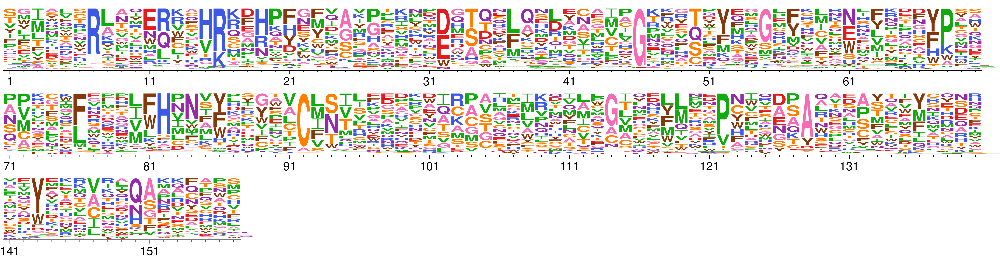

Here is the preferences logoplot with hypercomplementing scores penalized, rescaled according to stringency:


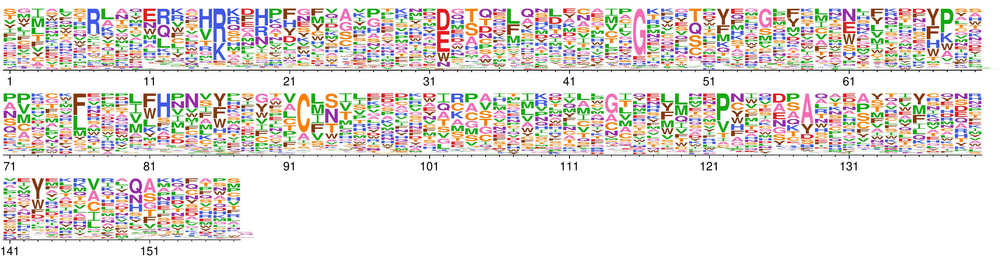

In [7]:
if not os.path.isdir('logoplots'):
    os.mkdir('logoplots')
for gene in genes:
    with open(f'./phydms_results/{gene}/{gene}_identity-ge-0.85_ExpCM_{gene}_penalize-scores-gt1_new_prefs_modelparams.txt') as f:
        beta = float([line.split('=')[1] for line in f.readlines() if 'beta' in line][0])
    print(f"\nFor gene {gene}, the stringency parameter is {beta}")
    print("Here is the preferences logoplot with hypercomplementing scores penalized:")
              
    subprocess.check_call(['phydms_logoplot',f'logoplots/{gene}_penalized_logoplot.pdf','--prefs',f'prefs/{gene}_penalize-scores-gt1_new_prefs.csv'],stdout=subprocess.DEVNULL)
    convertToPNG(f'logoplots/{gene}_penalized_logoplot.pdf')
    display(Image(filename=f'logoplots/{gene}_penalized_logoplot.png'))
              
    print("Here is the preferences logoplot with hypercomplementing scores penalized, rescaled according to stringency:")
              
    subprocess.check_call(['phydms_logoplot',f'logoplots/{gene}_penalized_beta_logoplot.pdf','--prefs',f'prefs/{gene}_penalize-scores-gt1_new_prefs.csv', '--stringency',str(beta)],stdout=subprocess.DEVNULL)
    convertToPNG(f'logoplots/{gene}_penalized_beta_logoplot.pdf')
    display(Image(filename=f'logoplots/{gene}_penalized_beta_logoplot.png'))
    

For all three genes, beta values below 1 indicate that selection is less stringent in the 85% orthologue set than what is observed in the deep mutational scans.  This is represented by a decrease in the dynamic range of character sizes, representing relative preferences.

## Detecting Differential Selection
Now that we have determined the best score transformation model for each gene, we can use phydms to detect sites under differential selection i.e. those where the amino acids favoured in nature differ from those favoured by deep mutational scanning.  This test involves running phydms_comprehensive with the --diffprefsbysite flag, and its results can be visualized via a phydms logoplot [5].

2022-10-06 14:10:35,382 - INFO - Beginning execution of phydms_comprehensive in directory /home/jupyter/dms/hmbs_phydms_final

2022-10-06 14:10:35,382 - INFO - Progress is being logged to phydms_differential_results/HMBS/HMBS_identity-ge-0.85.log

2022-10-06 14:10:35,382 - INFO - Version information:
	Time and date: Thu Oct  6 14:10:34 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

2022-10-06 14:10:35,382 - INFO - Parsed the following command-line arguments:
	outprefix = phydms_differential_results/HMBS/HMBS_identity-ge-0.85_
	alignment = 

Now plotting HMBS differential selection in logoplots/HMBS_selection.pdf.


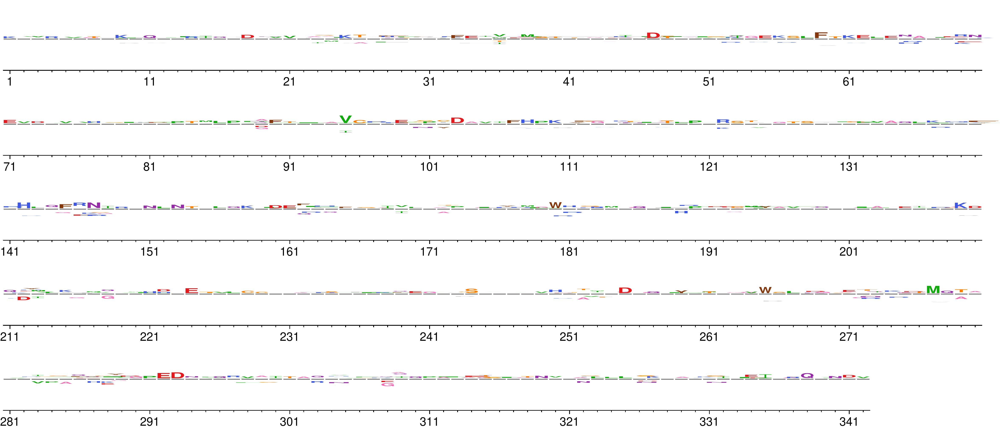

2022-10-06 14:32:38,439 - INFO - Beginning execution of phydms_comprehensive in directory /home/jupyter/dms/hmbs_phydms_final

2022-10-06 14:32:38,439 - INFO - Progress is being logged to phydms_differential_results/SUMO1/SUMO1_identity-ge-0.85.log

2022-10-06 14:32:38,440 - INFO - Version information:
	Time and date: Thu Oct  6 14:32:37 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

2022-10-06 14:32:38,440 - INFO - Parsed the following command-line arguments:
	outprefix = phydms_differential_results/SUMO1/SUMO1_identity-ge-0.85_
	alignmen

Now plotting SUMO1 differential selection in logoplots/SUMO1_selection.pdf.


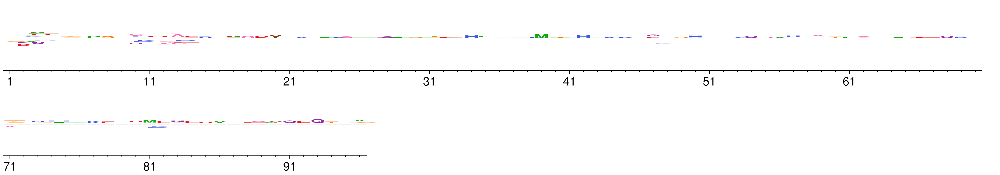

2022-10-06 14:38:07,355 - INFO - Beginning execution of phydms_comprehensive in directory /home/jupyter/dms/hmbs_phydms_final

2022-10-06 14:38:07,355 - INFO - Progress is being logged to phydms_differential_results/UBE2I/UBE2I_identity-ge-0.85.log

2022-10-06 14:38:07,355 - INFO - Version information:
	Time and date: Thu Oct  6 14:38:06 2022
	Platform: Linux-4.19.0-22-cloud-amd64-x86_64-with-debian-10.13
	Python version: 3.7.12 | packaged by conda-forge | (default, Oct 26 2021, 06:08:53)  [GCC 9.4.0]
	phydms version: 2.4.1
	Bio version: 1.79
	cython version: 0.29.32
	numpy version: 1.21.6
	scipy version: 1.7.3
	matplotlib version: 3.5.3
	natsort version: 8.2.0
	sympy version: 1.10.1
	six version: 1.16.0
	pandas version: 1.3.5
	pyvolve version: 1.1.0
	statsmodels version: 0.13.2
	weblogolib version: 3.5.0
	PyPDF2 version: 2.11.0

2022-10-06 14:38:07,355 - INFO - Parsed the following command-line arguments:
	outprefix = phydms_differential_results/UBE2I/UBE2I_identity-ge-0.85_
	alignmen

Now plotting UBE2I differential selection in logoplots/UBE2I_selection.pdf.


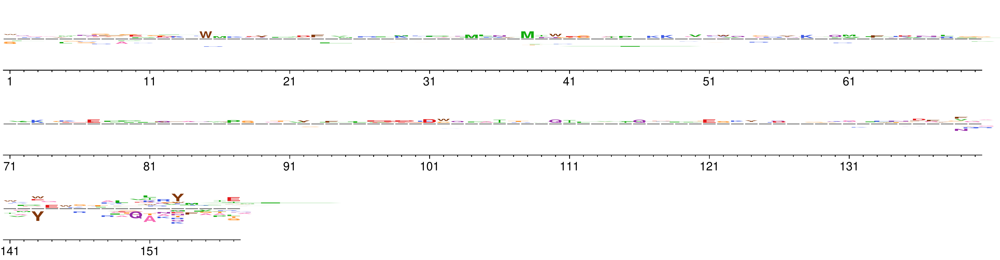

In [9]:
if not os.path.exists('phydms_differential_results'):
    os.mkdir('phydms_differential_results')
for gene in genes:
   
    outprefix = f'phydms_differential_results/{gene}/{gene}_identity-ge-0.85'
    diffsel = outprefix+f'_ExpCM_{gene}_penalize-scores-gt1_new_prefs_diffprefsbysite.txt'

    subprocess.call(['phydms_comprehensive',outprefix,f'./alignments/{gene}_alignment_protidentity_ge_0.85.fasta',f'./prefs/{gene}_penalize-scores-gt1_new_prefs.csv','--raxml','/home/jupyter/install/standard-RAxML-master/raxmlHPC','--diffprefsbysite','--no-avgprefs'],stdout=subprocess.DEVNULL)
    selectionplot = f'logoplots/{gene}_selection.pdf'
    print(f"Now plotting {gene} differential selection in {selectionplot}.")
    subprocess.check_call(['phydms_logoplot', '--diffprefs',diffsel, selectionplot,'--mapmetric','functionalgroup', '--colormap','mapmetric' ],stdout=subprocess.DEVNULL)
    convertToPNG(selectionplot)
    display(Image(filename=selectionplot.rstrip('.pdf')+'.png'))

In the logoplots, values above the central axis represent substitutions which are seen more frequently than expected by the DMS model, while values below the axis are seen less frequently than expected.  The overall small size of the characters indicates that there are no sites under especially strong differential selection.


## Conclusions

1) Like SUMO1 and UBE2I, the best-performing phylogenetic models for HMBS penalize hypercomplementing variants, indicating that these variants are best treated as deleterious in nature.

2) For HMBS, natural selection against less fit variants is less stringent than in deep mutational scanning experiments.

3) There are no amino acid sites in HMBS where the favoured variants differ significantly between DMS selection and natural evolution.

## References

1) Weile, J., Sun, S., Cote, A. G., Knapp, J., Verby, M., Mellor, J. C., Wu, Y., Pons, C., Wong, C., van Lieshout, N., Yang, F., Tasan, M., Tan, G., Yang, S., Fowler, D. M., Nussbaum, R., Bloom, J. D., Vidal, M., Hill, D. E., Aloy, P., … Roth, F. P. (2017). A framework for exhaustively mapping functional missense variants. Molecular systems biology, 13(12), 957. https://doi.org/10.15252/msb.20177908


2) Hilton, S. K., Doud, M. B., & Bloom, J. D. (2017). phydms: software for phylogenetic analyses informed by deep mutational scanning. PeerJ, 5, e3657. https://doi.org/10.7717/peerj.3657

3) Chen, B., Solis-Villa, C., Hakenberg, J., Qiao, W., Srinivasan, R. R., Yasuda, M., Balwani, M., Doheny, D., Peter, I., Chen, R., & Desnick, R. J. (2016). Acute Intermittent Porphyria: Predicted Pathogenicity of HMBS Variants Indicates Extremely Low Penetrance of the Autosomal Dominant Disease. Human mutation, 37(11), 1215–1222. https://doi.org/10.1002/humu.23067

4) Yang, Z., Nielsen, R., Goldman, N., & Pedersen, A. M. (2000). Codon-substitution models for heterogeneous selection pressure at amino acid sites. Genetics, 155(1), 431–449. https://doi.org/10.1093/genetics/155.1.431

5) Bloom, J., Hilton, S., Doud, M., & Dingens, A. (2018, January 25). phydms/phydms_tutorial.html at master · jbloomlab/phydms. GitHub. Retrieved October 6, 2022, from https://github.com/jbloomlab/phydms/blob/master/tutorial/phydms_tutorial.html